In [3]:
import os
import pandas as pd
import folium

In [4]:
cwd = os.getcwd()
if os.path.basename(cwd) == "Notebooks":
    project_root = os.path.dirname(cwd)
else:
    project_root = cwd
path = os.path.join(project_root, "data", "Airbnb_DK_Processed_Data.csv")
df = pd.read_csv(path)

In [4]:
# plot of Airbnb listings in CPH (5000 random samples)
cph_center = [55.6761, 12.5683]
m = folium.Map(location=cph_center, zoom_start=11, tiles='cartodbpositron')
for _, row in df.sample(5000, random_state=1).iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=1,
        color="red",
        fill=True,
        fill_opacity=0.6
    ).add_to(m)
m

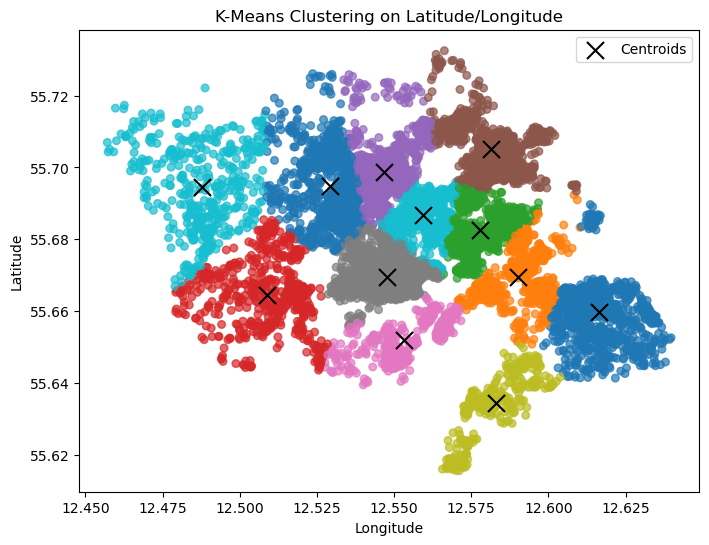

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# --- Assume df contains 'latitude' and 'longitude' columns ---

# Step 1: Extract coordinates
X = df[['longitude', 'latitude']].values

# Step 2: Choose number of clusters (you can tune this)
k = 12  # Example: 8 clusters
kmeans = KMeans(n_clusters=k, random_state=42)

# Step 3: Fit the model and get cluster labels
df['cluster'] = kmeans.fit_predict(X)

# Step 4: Add cluster centers
centers = kmeans.cluster_centers_

# Step 5: Plot clusters
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=df['cluster'], cmap='tab10', s=30, alpha=0.7)
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=150, marker='x', label='Centroids')
plt.title('K-Means Clustering on Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.show()


C:\Users\jakob\AppData\Local\Temp\ipykernel_1436\3949320297.py:22: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  palette = plt.cm.get_cmap('tab10', np.max(df['cluster']) + 2)


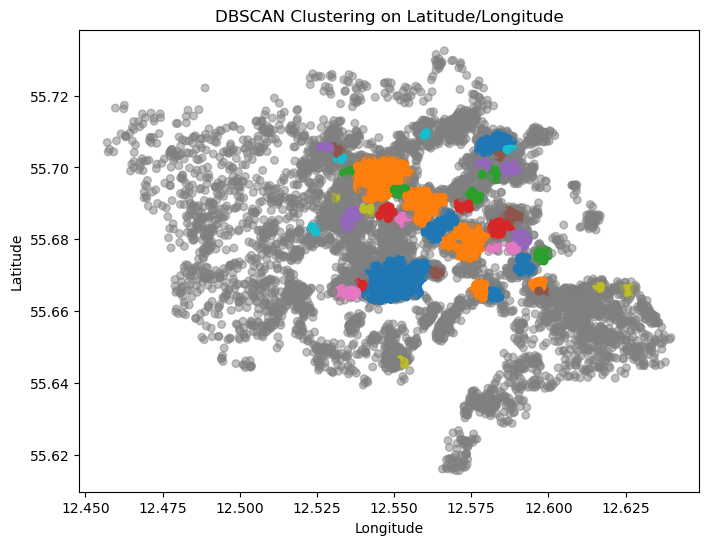

In [15]:
import pandas as pd
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# --- Assume df is already loaded and contains 'longitude' and 'latitude' columns ---

# Step 1: Extract the features
X = df[['longitude', 'latitude']].values

# Step 2: Standardize the data (important for DBSCAN performance)
X_scaled = StandardScaler().fit_transform(X)

# Step 3: Run DBSCAN
# eps controls the neighborhood radius; min_samples controls cluster density requirement
db = DBSCAN(eps=0.045, min_samples=20).fit(X_scaled)

# Step 4: Add cluster labels back to the dataframe
df['cluster'] = db.labels_

# Step 5: Plot the results
palette = plt.cm.get_cmap('tab10', np.max(df['cluster']) + 2)
colors = [palette(x) if x != -1 else (0.5, 0.5, 0.5, 0.5) for x in df['cluster']]
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=colors, s=30)
plt.title('DBSCAN Clustering on Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


c:\Users\jakob\anaconda3\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\jakob\anaconda3\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\jakob\AppData\Local\Temp\ipykernel_18568\816626039.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  palette = plt.cm.get_cmap('tab10', np.max(df['cluster']) + 2)


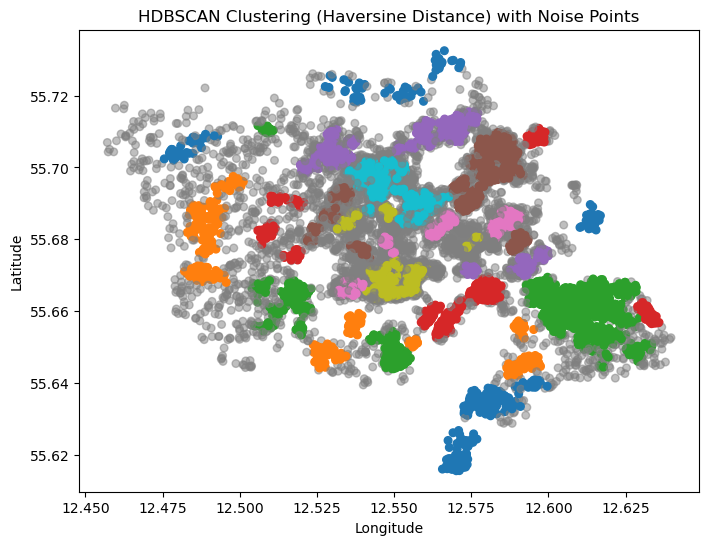

Clusters found: 80
Noise points: 3681


In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import hdbscan

# --- Assume df is already loaded and contains 'latitude' and 'longitude' columns ---

# Step 1: Extract coordinates
coords = df[['latitude', 'longitude']].values

# Step 2: Convert degrees to radians (required for haversine distance)
coords_rad = np.radians(coords)

# Step 3: Run HDBSCAN with Haversine metric
# min_cluster_size = minimum number of points per cluster
clusterer = hdbscan.HDBSCAN(min_cluster_size=12, metric='haversine')
cluster_labels = clusterer.fit_predict(coords_rad)

# Step 4: Add cluster labels to DataFrame
df['cluster'] = cluster_labels

# Step 5: Plot results
palette = plt.cm.get_cmap('tab10', np.max(df['cluster']) + 2)
colors = [palette(x) if x != -1 else (0.5, 0.5, 0.5, 0.5) for x in df['cluster']]
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=colors, s=30)
plt.title('HDBSCAN Clustering (Haversine Distance) with Noise Points')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

# Step 6: Print summary
num_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
num_noise = list(cluster_labels).count(-1)
print(f"Clusters found: {num_clusters}")
print(f"Noise points: {num_noise}")


In [4]:
import folium
import matplotlib.pyplot as plt
import numpy as np

# --- Assume df already contains: latitude, longitude, cluster ---

# Step 1: Create a base map centered around the data
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# Step 2: Define color palette
# Get unique cluster labels
clusters = sorted(df['cluster'].unique())

# Create a colormap using matplotlib (tab10 or any other)
cmap = plt.cm.get_cmap('tab10', len(clusters))
colors = {cluster: f'rgba({int(r*255)}, {int(g*255)}, {int(b*255)}, 0.8)'
          for cluster, (r, g, b, _) in zip(clusters, cmap(range(len(clusters))))}

# Step 3: Assign a neutral grey color to noise points (-1)
colors[-1] = 'rgba(150,150,150,0.5)'  # semi-transparent grey

# Step 4: Plot each point as a colored CircleMarker
for _, row in df.iterrows():
    cluster = row['cluster']
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color=colors[cluster],
        fill=True,
        fill_color=colors[cluster],
        fill_opacity=0.3,
        opacity=0.5,
        popup=f'Cluster: {cluster}'
    ).add_to(m)

# Step 5: Display the map
m


C:\Users\jakob\AppData\Local\Temp\ipykernel_9268\463443230.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', len(clusters))
